## Practical Work 4


For this practical work, the student will have to develop a Python program that is able to implement the accelerated gradient descent methods with adaptive learning rate <b>(Adagrad, RMSProp, and Adam)</b> in order to achieve the linear regression of a set of datapoints.

##### Please notice that we will apply these algorithm to single variable LR.


#### Import numpy, matplotlib.pyplot and make it inline


In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
import math
%matplotlib inline

To have a dataset or set of data points, the student must generate a pair of arrays <b>X</b> and <b>y</b> with the values in <b>X</b> equally distributed between <b>0</b> and <b>20</b> and the values in <b>y</b> such that:
<b>yi = a\*xi + b (and a = -1, b = 2)</b>


In [7]:
X = np.linspace(0,20)
X

array([ 0.        ,  0.40816327,  0.81632653,  1.2244898 ,  1.63265306,
        2.04081633,  2.44897959,  2.85714286,  3.26530612,  3.67346939,
        4.08163265,  4.48979592,  4.89795918,  5.30612245,  5.71428571,
        6.12244898,  6.53061224,  6.93877551,  7.34693878,  7.75510204,
        8.16326531,  8.57142857,  8.97959184,  9.3877551 ,  9.79591837,
       10.20408163, 10.6122449 , 11.02040816, 11.42857143, 11.83673469,
       12.24489796, 12.65306122, 13.06122449, 13.46938776, 13.87755102,
       14.28571429, 14.69387755, 15.10204082, 15.51020408, 15.91836735,
       16.32653061, 16.73469388, 17.14285714, 17.55102041, 17.95918367,
       18.36734694, 18.7755102 , 19.18367347, 19.59183673, 20.        ])

In [8]:
a=-1
b=2
y=a*X+b
y

array([  2.        ,   1.59183673,   1.18367347,   0.7755102 ,
         0.36734694,  -0.04081633,  -0.44897959,  -0.85714286,
        -1.26530612,  -1.67346939,  -2.08163265,  -2.48979592,
        -2.89795918,  -3.30612245,  -3.71428571,  -4.12244898,
        -4.53061224,  -4.93877551,  -5.34693878,  -5.75510204,
        -6.16326531,  -6.57142857,  -6.97959184,  -7.3877551 ,
        -7.79591837,  -8.20408163,  -8.6122449 ,  -9.02040816,
        -9.42857143,  -9.83673469, -10.24489796, -10.65306122,
       -11.06122449, -11.46938776, -11.87755102, -12.28571429,
       -12.69387755, -13.10204082, -13.51020408, -13.91836735,
       -14.32653061, -14.73469388, -15.14285714, -15.55102041,
       -15.95918367, -16.36734694, -16.7755102 , -17.18367347,
       -17.59183673, -18.        ])

#### Plot X vs. y


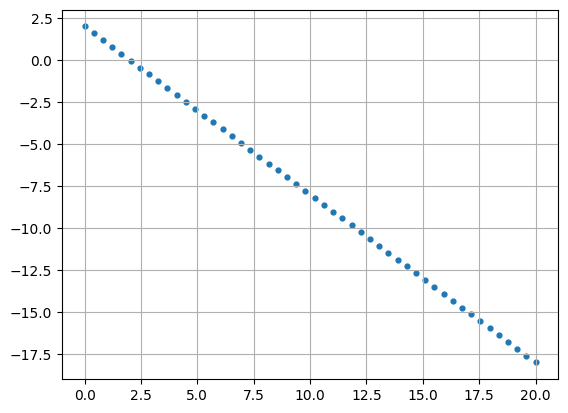

In [9]:
plt.scatter(X,y,s=12)
plt.grid(True)
plt.show()

## Adagrad


### For a single variable linear regression ML model, build a function to find the optimum Theta_0 and Theta_1 parameters using Adagrad optimization algorithm.

#### The funtion should have the following input parameters:

##### 1. Input data as a matrix (or vector based on your data).

##### 2. Target label as a vector.

##### 3. Learning rate.

##### 4. Epsilon.

##### 5. Maximum number of iterations (Epochs).

#### The funtion should return the following outputs:

##### 1. All predicted Theta_0 in all iterations.

##### 2. All predicted Theta_1 in all iterations.

##### 3. Corresponding loss for each Theta_0 and Theta_1 predictions.

##### 4.All hypothesis outputs (prdicted labels) for each Theta_0 and Theta_1 predictions.

##### 5.Final Optimum values of Theta_0 and Theta_1.

#### Choose the suitable number of iterations, learning rate, Epsilon, and stop criteria.

#### Calculate r2 score. Shouldn't below 0.9

#### Plot the required curves (loss-epochs, loss-theta0, loss-theta1, all fitted lines per epoch (single graph), best fit line)

#### Try different values of the huperparameters and see the differnce in your results.


##### The following results uses alpha = 0.05, epsilon = 1e-08, and max. iterations = 500.


In [32]:

def GD(data,target,learning_rate,epsilon,max_iterations):
    x_0 = np.ones(data.shape)
    theta_0 = 0
    theta_1 = 0
    adagrad_0=0
    adagrad_1=0
    theta_0_list=[]
    theta_1_list=[]
    loss=[]
    m=len(x_0)
    for i in range(max_iterations):
        print("************************* iter",i,"*************************")
        theta_0_list.append(theta_0)
        theta_1_list.append(theta_1)
        y_hat = theta_0*x_0+theta_1*data
        print("y_predict\n",y_hat)
        e = (y_hat-target)
        print("error vector\n",e)
        j = (np.linalg.norm(e)**2)/(2*m)
        loss.append(j)
        print('j =',j)
        Gradiant_vec = np.array([[np.sum(e)/m],[np.sum(e*data)/m]])
        print(Gradiant_vec)
        adagrad_0 = adagrad_0 + (Gradiant_vec[0,0]**2)
        adagrad_1 = adagrad_1 + (Gradiant_vec[1,0]**2)
        theta_0 = theta_0 - ((learning_rate/(math.sqrt(adagrad_0)+epsilon))*Gradiant_vec[0,0])
        theta_1 = theta_1 - ((learning_rate/(math.sqrt(adagrad_1)+epsilon))*Gradiant_vec[1,0])
        print(theta_0)
        print(theta_1)
        Gradiant_vec_norm = np.linalg.norm(Gradiant_vec)
        print("Gradiant_vec_norm =",Gradiant_vec_norm)
        if Gradiant_vec_norm < 0.001:
            break
        if i>=2:
            if abs(loss[-1]-loss[-2])<0.001:
                break
    return theta_0_list,theta_1_list,loss,theta_0,theta_1
def r2_s(theta_0,theta_1,X,y):
    print(theta_0)
    print(theta_1)
    x_0 = np.ones(X.shape)
    y_hat = theta_0*x_0+theta_1*X
    print(y_hat)
    print(r2_score(y,y_hat))
def plot_loss_epocs(loss_list):
    xaxis=np.linspace(0,len(loss_list),len(loss_list))
    plt.grid(True)
    plt.plot(xaxis,loss_list,marker="o")
    plt.show()
def plot_theta_loss(loss_list,theta_0_list,theta_1_list):
    plt.plot(theta_0_list,loss_list,marker="o")
    plt.grid(True)
    plt.xlabel("theta_0")
    plt.ylabel("loss")
    plt.show()
    plt.clf()
    plt.plot(theta_1_list,loss_list,marker="o")
    plt.grid(True)
    plt.xlabel("theta_1")
    plt.ylabel("loss")
    plt.show()
def plot_regression_lines(theta_0_list,theta_1_list,x,y):
    plt.scatter(x,y,s=12)
    plt.grid(True)
    for i in range(len(theta_0_list)):
        x0=np.ones(x.shape)
        y_hat=theta_0_list[i]*x0+theta_1_list[i]*X
        plt.plot(X,y_hat,'red')
    plt.grid(True)
    plt.show()
def plot_best_regression_line(theta_0,theta_1,x,y):
    plt.scatter(x,y,s=12)
    x0=np.ones(x.shape)
    plt.grid(True)
    y_hat=theta_0*x0+theta_1*X
    plt.plot(X,y_hat,'red')
    plt.show()
    

In [33]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.05,1e-08,500)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.0499999999375
-0.04999999999564057
Gradiant_vec_norm = 114.97254258164628
********************

In [34]:
r2_s(theta_0,theta_1,X,y)

-0.5954258701060547
-0.7878639328531859
[ -0.59542587  -0.91700299  -1.2385801   -1.56015722  -1.88173433
  -2.20331145  -2.52488856  -2.84646568  -3.16804279  -3.48961991
  -3.81119702  -4.13277414  -4.45435126  -4.77592837  -5.09750549
  -5.4190826   -5.74065972  -6.06223683  -6.38381395  -6.70539106
  -7.02696818  -7.34854529  -7.67012241  -7.99169953  -8.31327664
  -8.63485376  -8.95643087  -9.27800799  -9.5995851   -9.92116222
 -10.24273933 -10.56431645 -10.88589356 -11.20747068 -11.5290478
 -11.85062491 -12.17220203 -12.49377914 -12.81535626 -13.13693337
 -13.45851049 -13.7800876  -14.10166472 -14.42324183 -14.74481895
 -15.06639607 -15.38797318 -15.7095503  -16.03112741 -16.35270453]
0.948520552065235


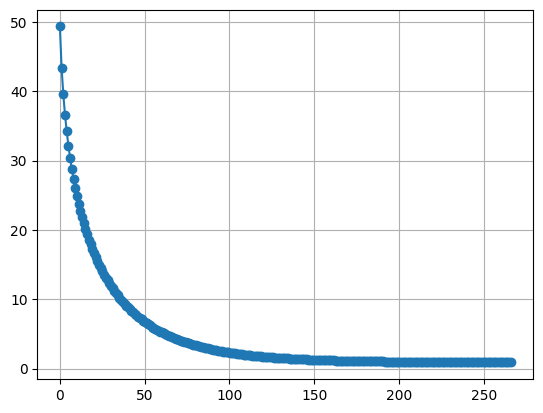

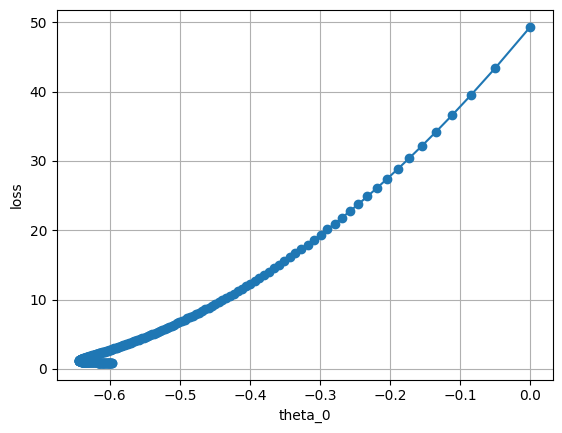

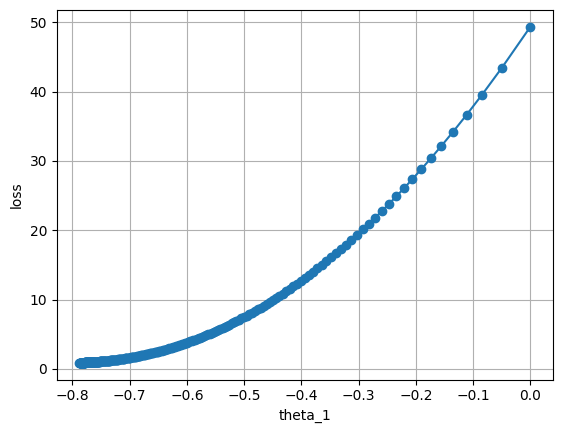

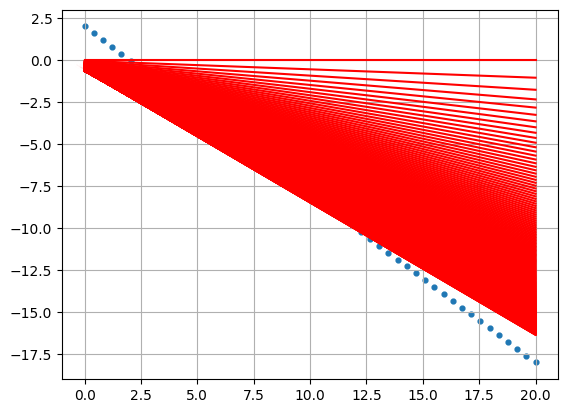

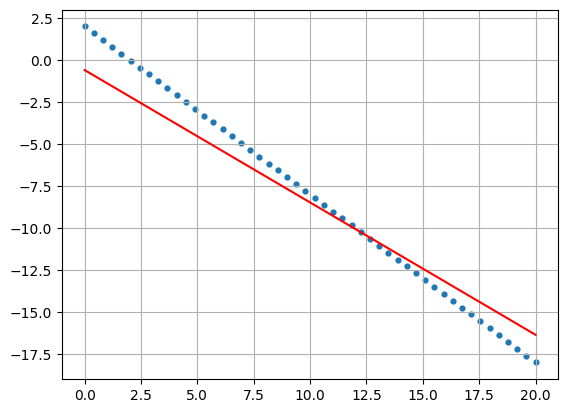

In [ ]:
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.005, epsilon = 1e-08, and max. iterations = 5000.


In [36]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.005,1e-08,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.00499999999375
-0.004999999999564057
Gradiant_vec_norm = 114.97254258164628
******************

-0.5400968829191174
-0.5615340004045978
[ -0.54009688  -0.76929443  -0.99849199  -1.22768954  -1.45688709
  -1.68608464  -1.91528219  -2.14447974  -2.37367729  -2.60287484
  -2.83207239  -3.06126995  -3.2904675   -3.51966505  -3.7488626
  -3.97806015  -4.2072577   -4.43645525  -4.6656528   -4.89485036
  -5.12404791  -5.35324546  -5.58244301  -5.81164056  -6.04083811
  -6.27003566  -6.49923321  -6.72843076  -6.95762832  -7.18682587
  -7.41602342  -7.64522097  -7.87441852  -8.10361607  -8.33281362
  -8.56201117  -8.79120873  -9.02040628  -9.24960383  -9.47880138
  -9.70799893  -9.93719648 -10.16639403 -10.39559158 -10.62478914
 -10.85398669 -11.08318424 -11.31238179 -11.54157934 -11.77077689]
0.7096780137749918


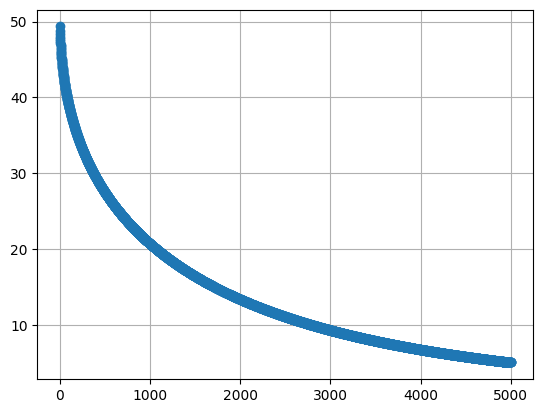

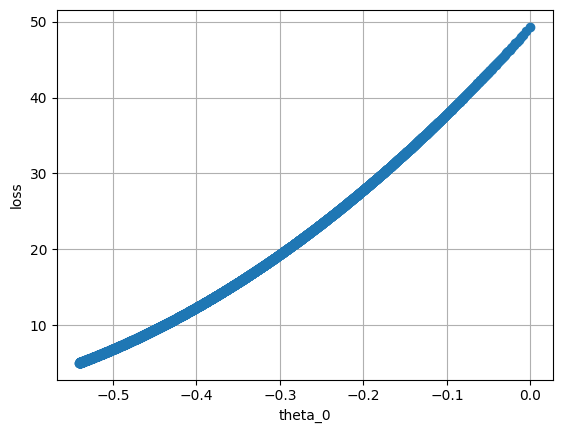

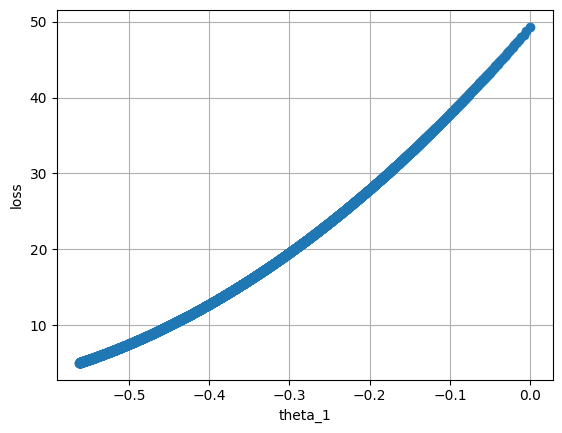

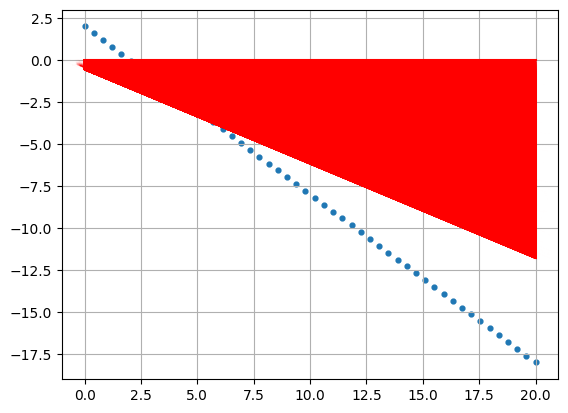

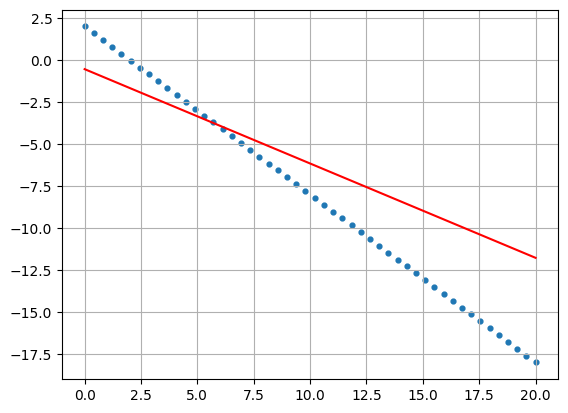

In [37]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.0005, epsilon = 1e-08, and max. iterations = 5000.


In [40]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.0005,1e-08,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.000499999999375
-0.0004999999999564057
Gradiant_vec_norm = 114.97254258164628
****************

-0.054285891047180124
-0.054348131537674635
[-0.05428589 -0.0764688  -0.09865171 -0.12083462 -0.14301753 -0.16520045
 -0.18738336 -0.20956627 -0.23174918 -0.25393209 -0.276115   -0.29829791
 -0.32048082 -0.34266373 -0.36484664 -0.38702955 -0.40921246 -0.43139538
 -0.45357829 -0.4757612  -0.49794411 -0.52012702 -0.54230993 -0.56449284
 -0.58667575 -0.60885866 -0.63104157 -0.65322448 -0.67540739 -0.69759031
 -0.71977322 -0.74195613 -0.76413904 -0.78632195 -0.80850486 -0.83068777
 -0.85287068 -0.87505359 -0.8972365  -0.91941941 -0.94160232 -0.96378524
 -0.98596815 -1.00815106 -1.03033397 -1.05251688 -1.07469979 -1.0968827
 -1.11906561 -1.14124852]
-1.473586554081792


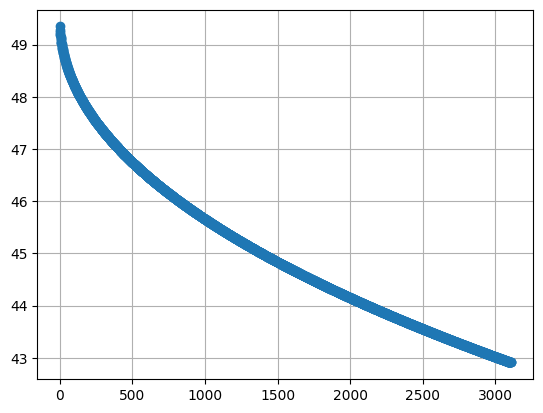

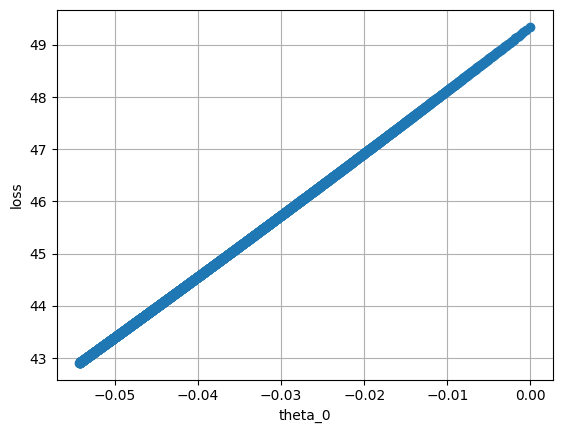

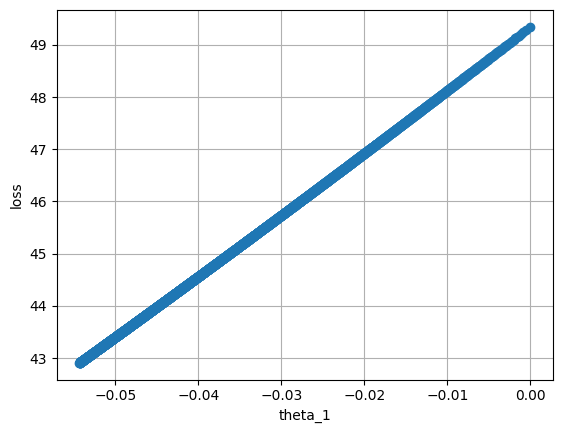

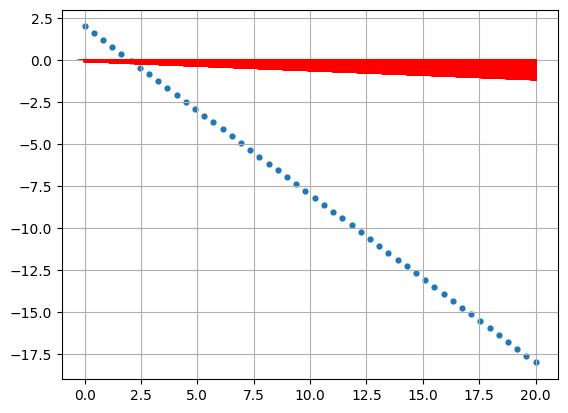

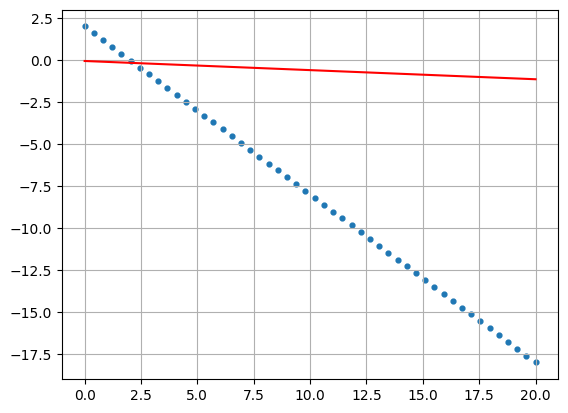

In [41]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

## RMSProp


### Update the previos implementation to be RMSProp.

#### Compare your results with Adagrad results.


In [42]:
def GD(data,target,learning_rate,epsilon,beta,max_iterations):
    x_0 = np.ones(data.shape)
    theta_0 = 0
    theta_1 = 0
    adagrad_0=0
    adagrad_1=0
    theta_0_list=[]
    theta_1_list=[]
    loss=[]
    m=len(x_0)
    for i in range(max_iterations):
        print("************************* iter",i,"*************************")
        theta_0_list.append(theta_0)
        theta_1_list.append(theta_1)
        y_hat = theta_0*x_0+theta_1*data
        print("y_predict\n",y_hat)
        e = (y_hat-target)
        print("error vector\n",e)
        j = (np.linalg.norm(e)**2)/(2*m)
        loss.append(j)
        print('j =',j)
        Gradiant_vec = np.array([[np.sum(e)/m],[np.sum(e*data)/m]])
        print(Gradiant_vec)
        adagrad_0 = beta*adagrad_0 + (1-beta)*(Gradiant_vec[0,0]**2)
        adagrad_1 = beta*adagrad_1 + (1-beta)*(Gradiant_vec[1,0]**2)
        theta_0 = theta_0 - ((learning_rate/(math.sqrt(adagrad_0)+epsilon))*Gradiant_vec[0,0])
        theta_1 = theta_1 - ((learning_rate/(math.sqrt(adagrad_1)+epsilon))*Gradiant_vec[1,0])
        print(theta_0)
        print(theta_1)
        Gradiant_vec_norm = np.linalg.norm(Gradiant_vec)
        print("Gradiant_vec_norm =",Gradiant_vec_norm)
        if Gradiant_vec_norm < 0.001:
            break
        if i>=2:
            if abs(loss[-1]-loss[-2])<0.001:
                break
    return theta_0_list,theta_1_list,loss,theta_0,theta_1

##### The following results uses alpha = 0.05, beta = 0.9, epsilon = 1e-08, and max. iterations = 500.


In [43]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.05,1e-08,0.9,500)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.158113882383419
-0.1581138829648247
Gradiant_vec_norm = 114.97254258164628
*******************

1.7217688690664152
-0.981663183317611
[  1.72176887   1.32109002   0.92041117   0.51973232   0.11905347
  -0.28162538  -0.68230423  -1.08298308  -1.48366193  -1.88434078
  -2.28501963  -2.68569848  -3.08637733  -3.48705619  -3.88773504
  -4.28841389  -4.68909274  -5.08977159  -5.49045044  -5.89112929
  -6.29180814  -6.69248699  -7.09316584  -7.49384469  -7.89452354
  -8.29520239  -8.69588124  -9.09656009  -9.49723894  -9.89791779
 -10.29859664 -10.69927549 -11.09995434 -11.50063319 -11.90131204
 -12.30199089 -12.70266974 -13.10334859 -13.50402744 -13.90470629
 -14.30538514 -14.70606399 -15.10674284 -15.5074217  -15.90810055
 -16.3087794  -16.70945825 -17.1101371  -17.51081595 -17.9114948 ]
0.9994043787327658


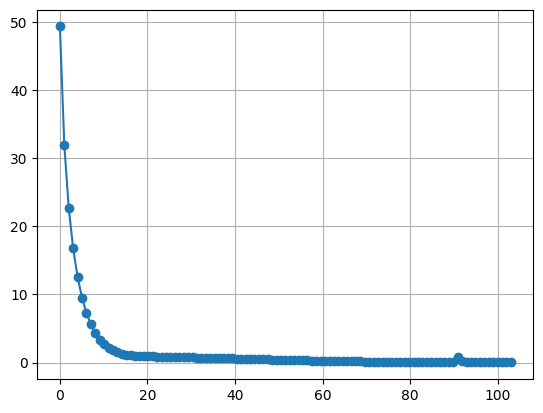

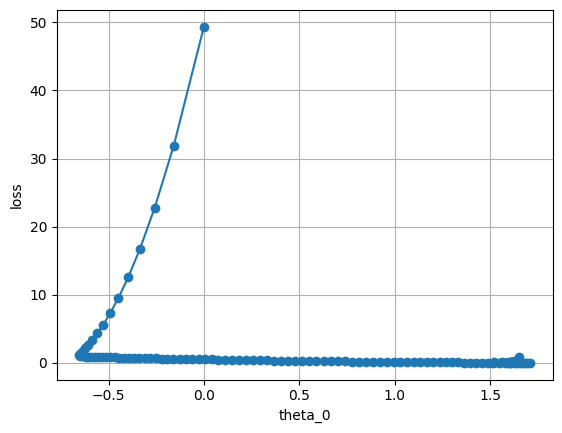

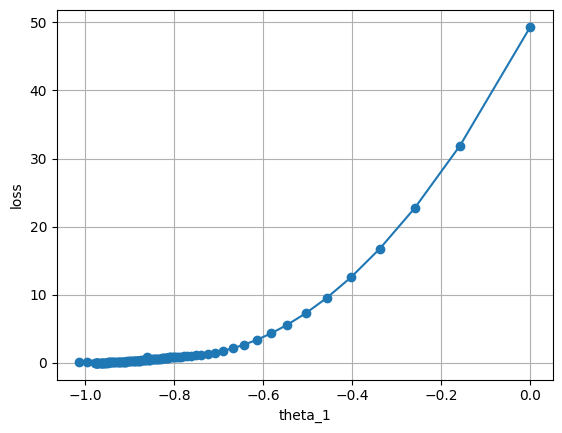

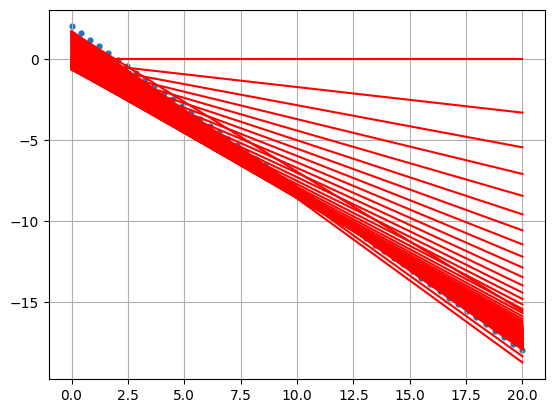

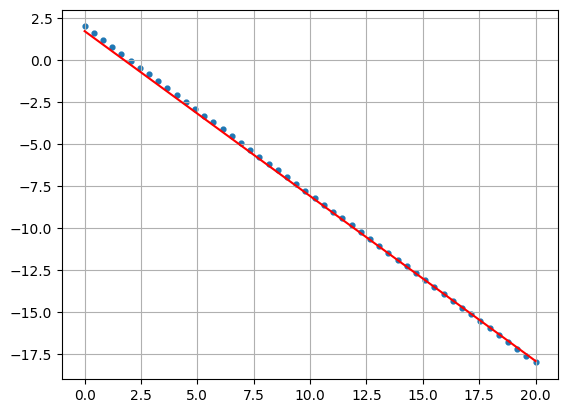

In [44]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.005, beta = 0.9, epsilon = 1e-08, and max. iterations = 5000.


In [45]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.005,1e-08,0.9,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.0158113882383419
-0.01581138829648247
Gradiant_vec_norm = 114.97254258164628
*****************

1.1738205485468591
-0.9409897143587622
[  1.17382055   0.78974311   0.40566568   0.02158825  -0.36248919
  -0.74656662  -1.13064406  -1.51472149  -1.89879893  -2.28287636
  -2.6669538   -3.05103123  -3.43510866  -3.8191861   -4.20326353
  -4.58734097  -4.9714184   -5.35549584  -5.73957327  -6.12365071
  -6.50772814  -6.89180557  -7.27588301  -7.65996044  -8.04403788
  -8.42811531  -8.81219275  -9.19627018  -9.58034762  -9.96442505
 -10.34850248 -10.73257992 -11.11665735 -11.50073479 -11.88481222
 -12.26888966 -12.65296709 -13.03704453 -13.42112196 -13.80519939
 -14.18927683 -14.57335426 -14.9574317  -15.34150913 -15.72558657
 -16.109664   -16.49374144 -16.87781887 -17.2618963  -17.64597374]
0.9949113886723183


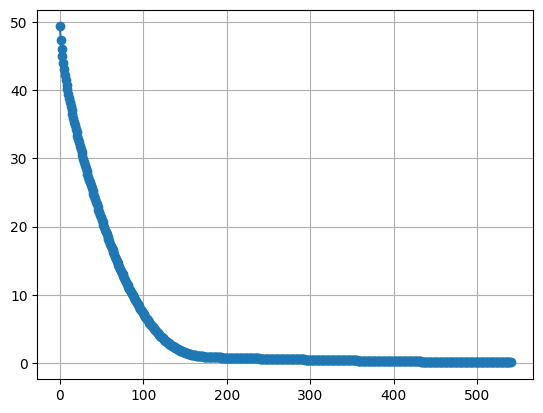

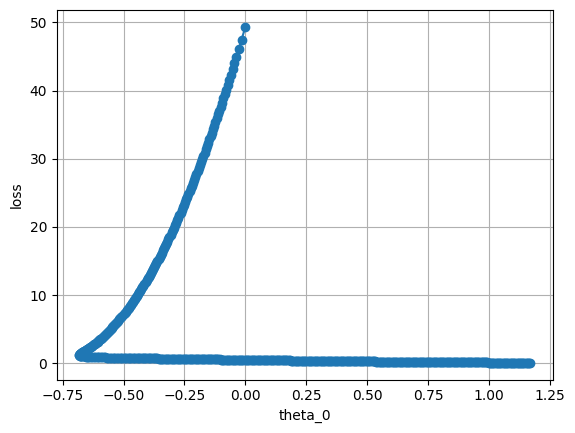

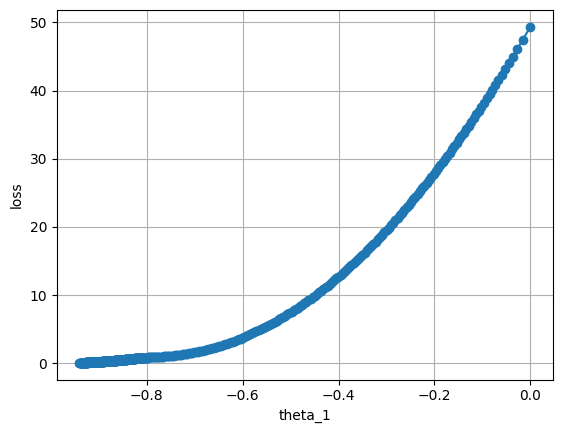

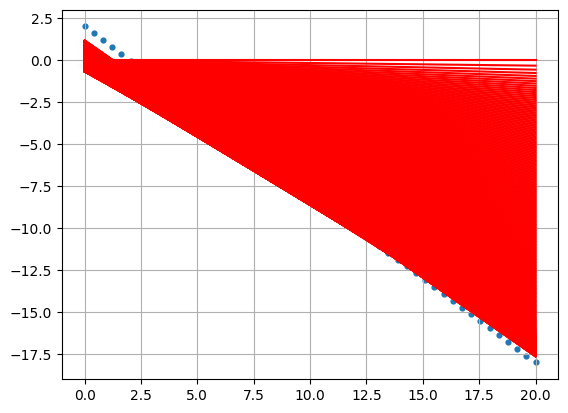

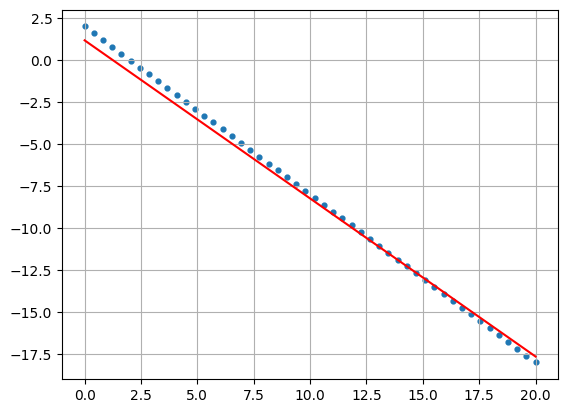

In [46]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.0005, beta = 0.9, epsilon = 1e-08, and max. iterations = 5000.


In [47]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.0005,1e-08,0.9,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.00158113882383419
-0.001581138829648247
Gradiant_vec_norm = 114.97254258164628
***************

-0.6384902049160882
-0.7912686408840164
[ -0.6384902   -0.961457    -1.28442379  -1.60739058  -1.93035737
  -2.25332417  -2.57629096  -2.89925775  -3.22222454  -3.54519133
  -3.86815813  -4.19112492  -4.51409171  -4.8370585   -5.1600253
  -5.48299209  -5.80595888  -6.12892567  -6.45189246  -6.77485926
  -7.09782605  -7.42079284  -7.74375963  -8.06672643  -8.38969322
  -8.71266001  -9.0356268   -9.35859359  -9.68156039 -10.00452718
 -10.32749397 -10.65046076 -10.97342756 -11.29639435 -11.61936114
 -11.94232793 -12.26529472 -12.58826152 -12.91122831 -13.2341951
 -13.55716189 -13.88012869 -14.20309548 -14.52606227 -14.84902906
 -15.17199585 -15.49496265 -15.81792944 -16.14089623 -16.46386302]
0.9476747565933363


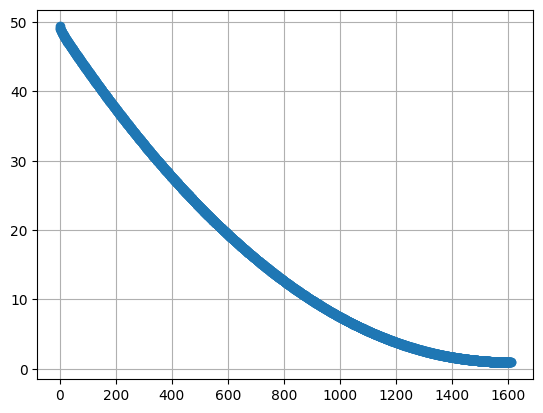

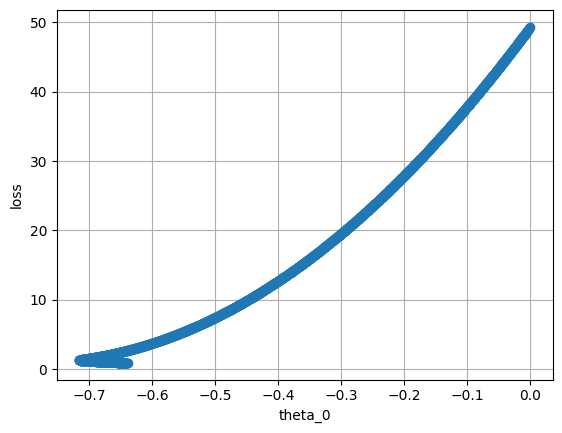

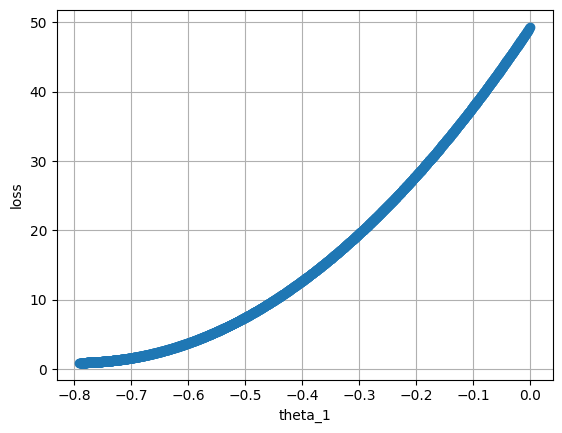

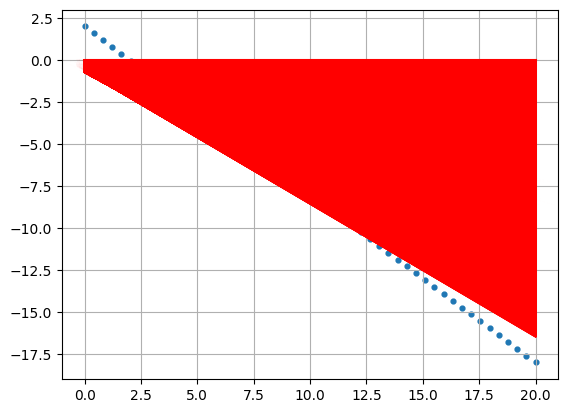

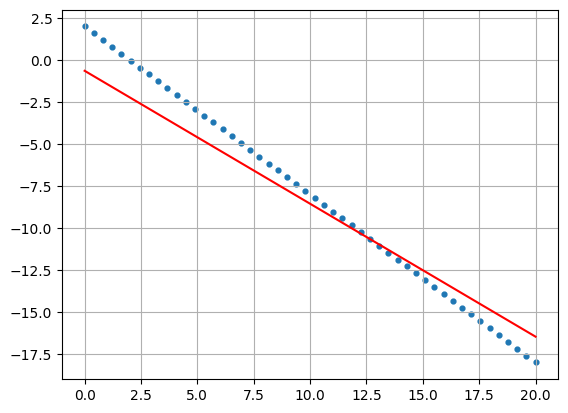

In [48]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

## Adam


### Update the previos implementation to be Adam.

#### Compare your results with Adagrad and RMSProp results.


In [76]:
def GD(data,target,learning_rate,epsilon,beta1,beta2,max_iterations):
    x_0 = np.ones(data.shape)
    theta_0 = 0
    theta_1 = 0
    adagrad_0=0
    adagrad_1=0
    moment_0 =0
    moment_1 =0
    theta_0_list=[]
    theta_1_list=[]
    loss=[]
    m=len(x_0)
    for i in range(max_iterations):
        print("************************* iter",i,"*************************")
        theta_0_list.append(theta_0)
        theta_1_list.append(theta_1)
        y_hat = theta_0*x_0+theta_1*data
        print("y_predict\n",y_hat)
        e = (y_hat-target)
        print("error vector\n",e)
        j = (np.linalg.norm(e)**2)/(2*m)
        loss.append(j)
        print('j =',j)
        Gradiant_vec = np.array([[np.sum(e)/m],[np.sum(e*data)/m]])
        print(Gradiant_vec)
        moment_0 = beta1*moment_0 + (1-beta1)*Gradiant_vec[0,0]
        moment_1 = beta1*moment_1 + (1-beta1)*Gradiant_vec[1,0]
        adagrad_0 = beta2*adagrad_0 + (1-beta2)*(Gradiant_vec[0,0]**2)
        adagrad_1 = beta2*adagrad_1 + (1-beta2)*(Gradiant_vec[1,0]**2)
        moment_0_hat = moment_0/(1-beta1)
        moment_1_hat = moment_1/(1-beta1)
        adagrad_0_hat = adagrad_0/(1-beta2)
        adagrad_1_hat = adagrad_1/(1-beta2)
        theta_0 = theta_0 - ((learning_rate/(math.sqrt(adagrad_0_hat)+epsilon))*moment_0_hat)
        theta_1 = theta_1 - ((learning_rate/(math.sqrt(adagrad_1_hat)+epsilon))*moment_1_hat)
        print(theta_0)
        print(theta_1)
        Gradiant_vec_norm = np.linalg.norm(Gradiant_vec)
        print("Gradiant_vec_norm =",Gradiant_vec_norm)
        if Gradiant_vec_norm < 0.001:
            break
        if i>=2:
            if abs(loss[-1]-loss[-2])<0.001:
                break
    return theta_0_list,theta_1_list,loss,theta_0,theta_1

##### The following results uses alpha = 0.05, beta1 = 0.2, beta2 = 0.7, epsilon = 1e-08, and max. iterations = 500.


In [70]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.05,1e-08,0.2,0.7,500)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.0499999999375
-0.04999999999564057
Gradiant_vec_norm = 114.97254258164628
********************

1.8982809219747139
-0.983128578441301
[  1.89828092   1.49700395   1.09572698   0.69445001   0.29317304
  -0.10810393  -0.5093809   -0.91065787  -1.31193484  -1.71321182
  -2.11448879  -2.51576576  -2.91704273  -3.3183197   -3.71959667
  -4.12087364  -4.52215061  -4.92342758  -5.32470455  -5.72598152
  -6.12725849  -6.52853546  -6.92981244  -7.33108941  -7.73236638
  -8.13364335  -8.53492032  -8.93619729  -9.33747426  -9.73875123
 -10.1400282  -10.54130517 -10.94258214 -11.34385911 -11.74513608
 -12.14641306 -12.54769003 -12.948967   -13.35024397 -13.75152094
 -14.15279791 -14.55407488 -14.95535185 -15.35662882 -15.75790579
 -16.15918276 -16.56045973 -16.96173671 -17.36301368 -17.76429065]
0.9995859850908306


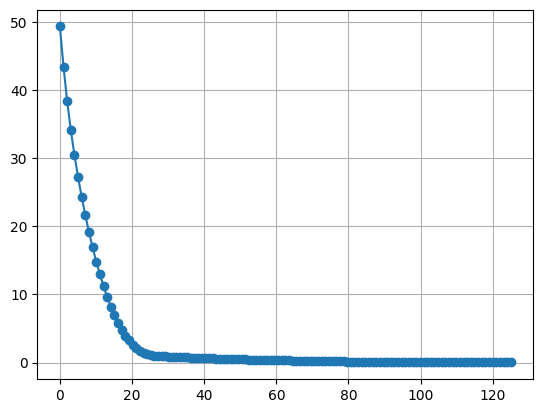

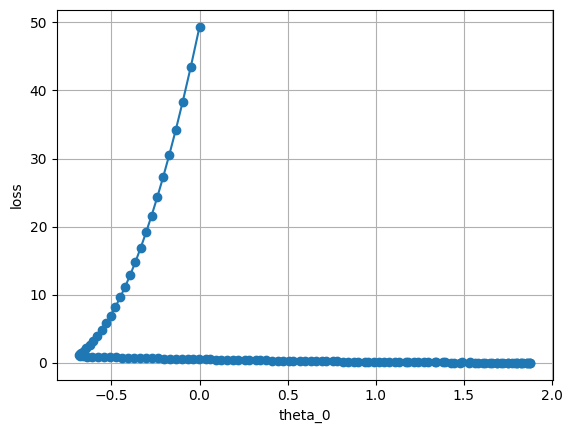

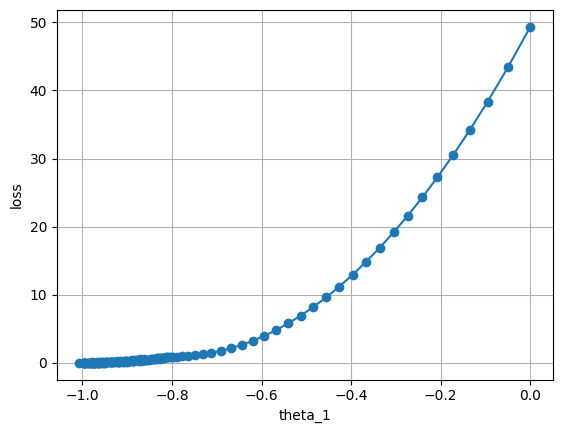

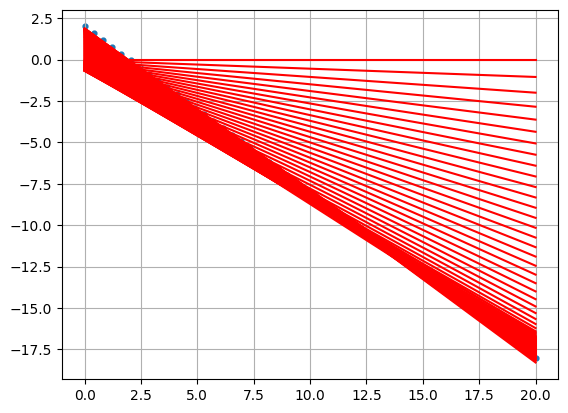

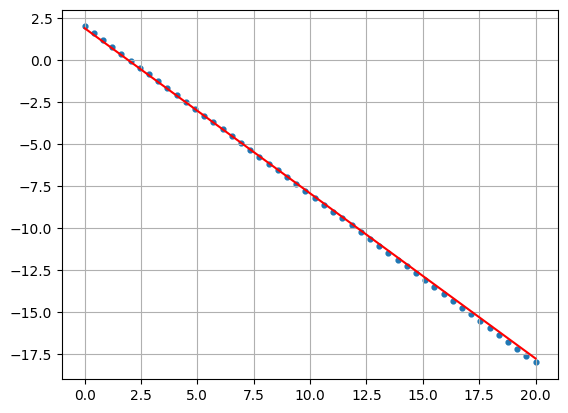

In [71]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.005, beta1 = 0.5, beta2 = 0.8, epsilon = 1e-08, and max. iterations = 500.


In [72]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.005,1e-08,0.5,0.8,500)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.00499999999375
-0.004999999999564057
Gradiant_vec_norm = 114.97254258164628
******************

0.7612757097828742
-0.9080167511594449
[  0.76127571   0.39065663   0.02003755  -0.35058154  -0.72120062
  -1.0918197   -1.46243878  -1.83305786  -2.20367695  -2.57429603
  -2.94491511  -3.31553419  -3.68615328  -4.05677236  -4.42739144
  -4.79801052  -5.1686296   -5.53924869  -5.90986777  -6.28048685
  -6.65110593  -7.02172501  -7.3923441   -7.76296318  -8.13358226
  -8.50420134  -8.87482042  -9.24543951  -9.61605859  -9.98667767
 -10.35729675 -10.72791584 -11.09853492 -11.469154   -11.83977308
 -12.21039216 -12.58101125 -12.95163033 -13.32224941 -13.69286849
 -14.06348757 -14.43410666 -14.80472574 -15.17534482 -15.5459639
 -15.91658298 -16.28720207 -16.65782115 -17.02844023 -17.39905931]
0.9886079601198724


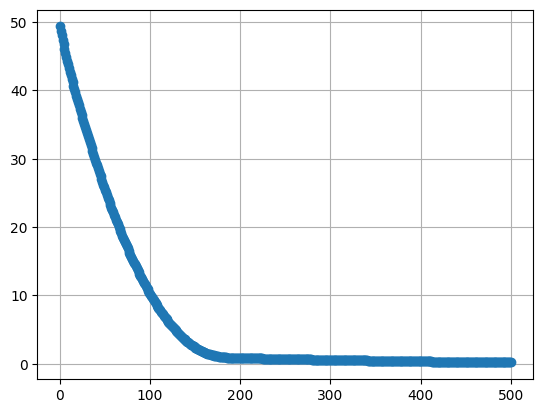

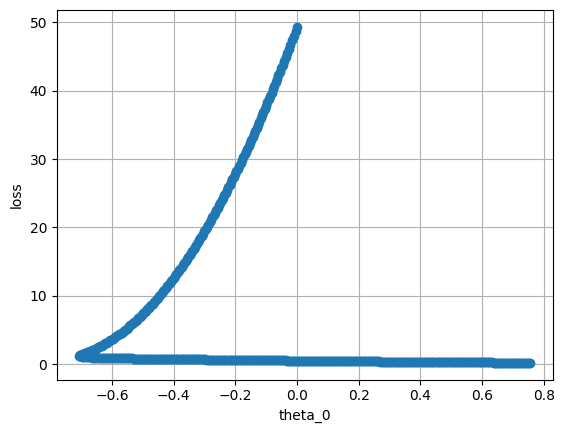

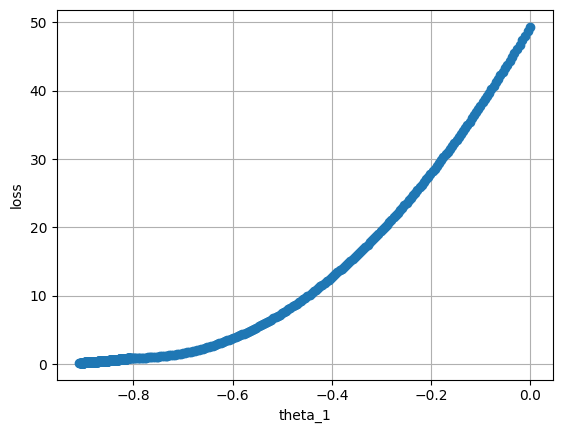

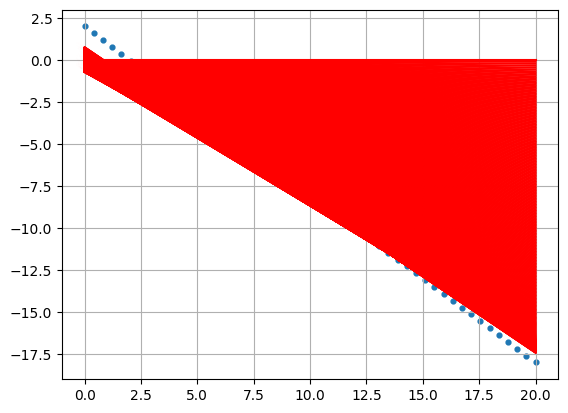

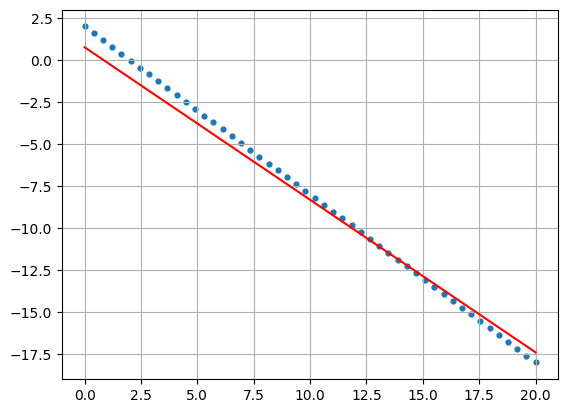

In [73]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.0005, beta1 = 0.8, beta2 = 0.8, epsilon = 1e-08, and max. iterations = 5000.


In [77]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.0005,1e-08,0.8,0.8,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.000499999999375
-0.0004999999999564057
Gradiant_vec_norm = 114.97254258164628
****************

-0.6605685042376135
-0.8022866427623648
[ -0.6605685   -0.98803244  -1.31549638  -1.64296031  -1.97042425
  -2.29788818  -2.62535212  -2.95281605  -3.28027999  -3.60774393
  -3.93520786  -4.2626718   -4.59013573  -4.91759967  -5.24506361
  -5.57252754  -5.89999148  -6.22745541  -6.55491935  -6.88238328
  -7.20984722  -7.53731116  -7.86477509  -8.19223903  -8.51970296
  -8.8471669   -9.17463084  -9.50209477  -9.82955871 -10.15702264
 -10.48448658 -10.81195051 -11.13941445 -11.46687839 -11.79434232
 -12.12180626 -12.44927019 -12.77673413 -13.10419807 -13.431662
 -13.75912594 -14.08658987 -14.41405381 -14.74151774 -15.06898168
 -15.39644562 -15.72390955 -16.05137349 -16.37883742 -16.70630136]
0.9474464389590456


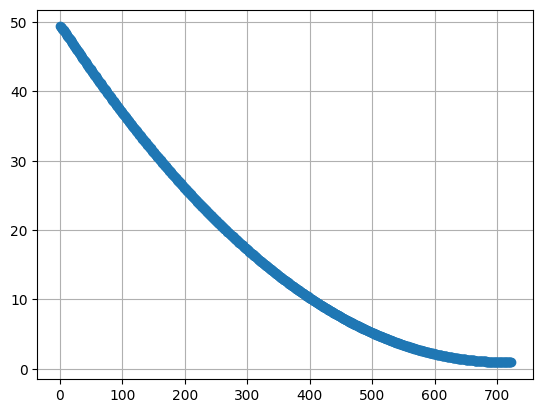

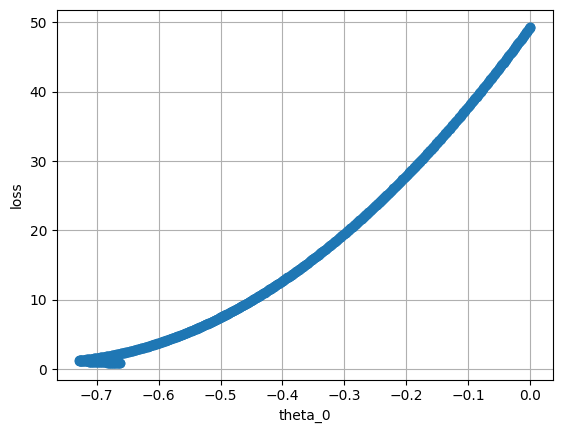

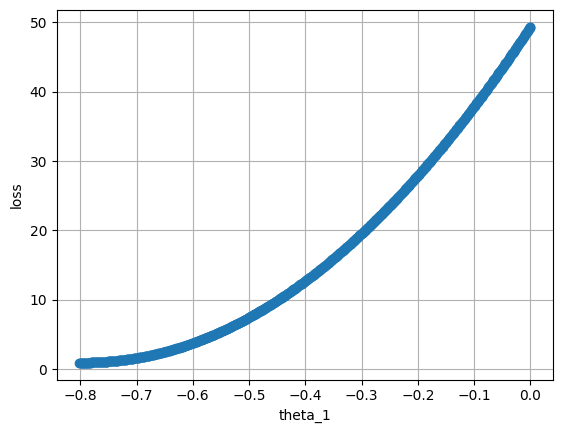

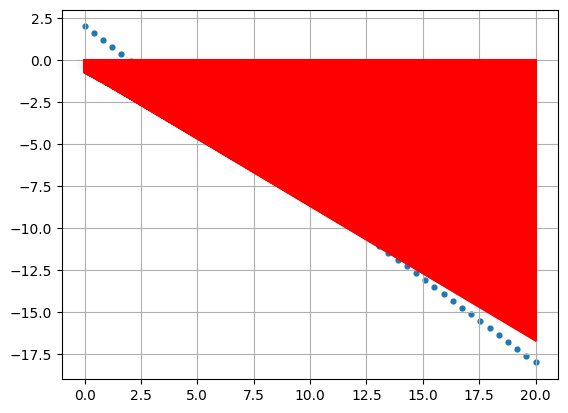

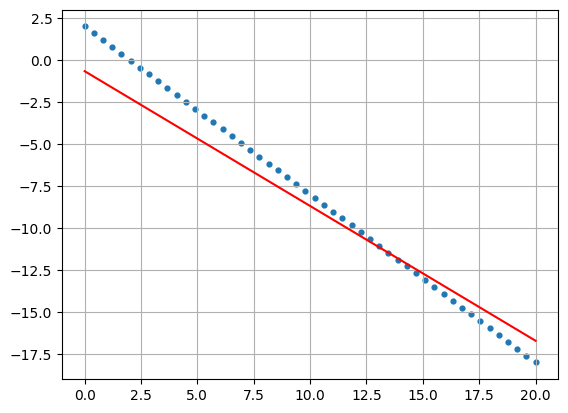

In [78]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

### Play with the parameters and see the results


##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.99, epsilon = 1e-08, and max. iterations = 5000.


In [79]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.001,1e-08,0.9,0.99,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.00099999999875
-0.0009999999999128113
Gradiant_vec_norm = 114.97254258164628
*****************

-0.6028847297007071
-0.7901902021177398
[ -0.60288473  -0.92541134  -1.24793796  -1.57046457  -1.89299118
  -2.2155178   -2.53804441  -2.86057102  -3.18309763  -3.50562425
  -3.82815086  -4.15067747  -4.47320409  -4.7957307   -5.11825731
  -5.44078393  -5.76331054  -6.08583715  -6.40836377  -6.73089038
  -7.05341699  -7.3759436   -7.69847022  -8.02099683  -8.34352344
  -8.66605006  -8.98857667  -9.31110328  -9.6336299   -9.95615651
 -10.27868312 -10.60120974 -10.92373635 -11.24626296 -11.56878958
 -11.89131619 -12.2138428  -12.53636941 -12.85889603 -13.18142264
 -13.50394925 -13.82647587 -14.14900248 -14.47152909 -14.79405571
 -15.11658232 -15.43910893 -15.76163555 -16.08416216 -16.40668877]
0.9486353348718748


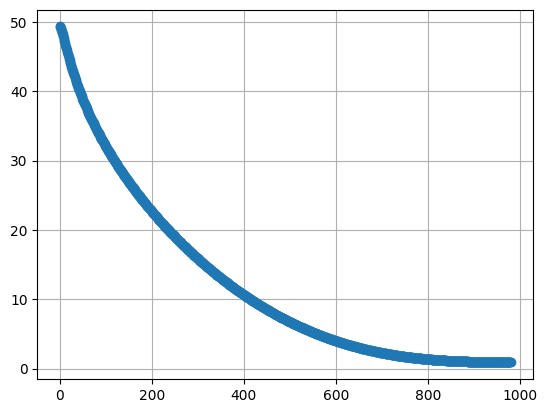

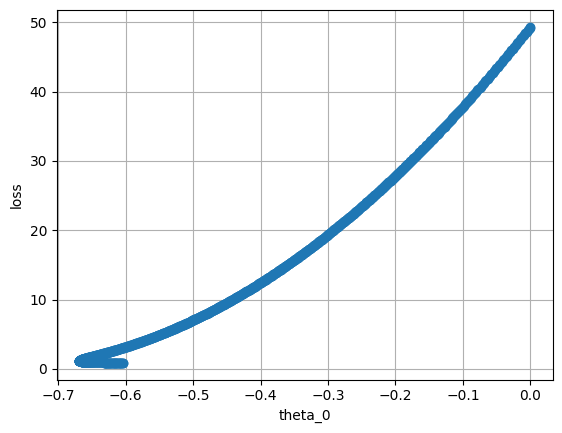

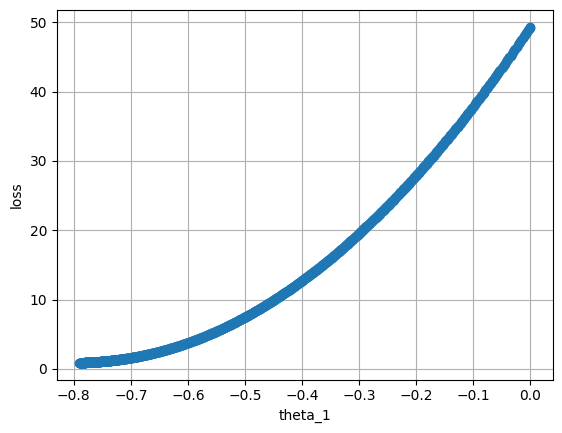

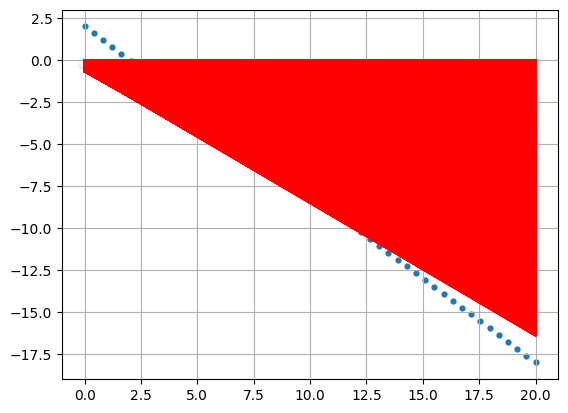

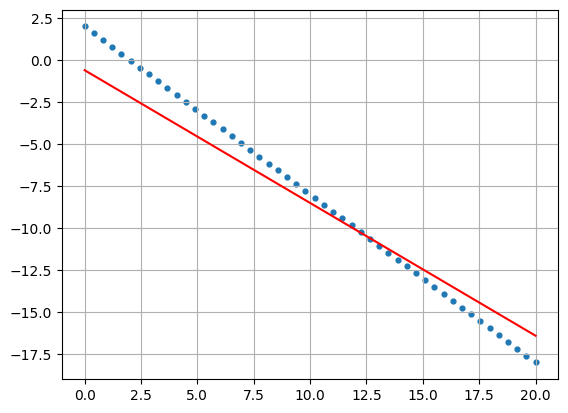

In [80]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.5, epsilon = 1e-08, and max. iterations = 5000.


In [81]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.001,1e-08,0.9,0.5,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.00099999999875
-0.0009999999999128113
Gradiant_vec_norm = 114.97254258164628
*****************

-0.8790808827188362
-0.8254688144296224
[ -0.87908088  -1.21600693  -1.55293298  -1.88985902  -2.22678507
  -2.56371112  -2.90063716  -3.23756321  -3.57448926  -3.9114153
  -4.24834135  -4.5852674   -4.92219344  -5.25911949  -5.59604554
  -5.93297158  -6.26989763  -6.60682368  -6.94374972  -7.28067577
  -7.61760182  -7.95452786  -8.29145391  -8.62837996  -8.965306
  -9.30223205  -9.6391581   -9.97608414 -10.31301019 -10.64993624
 -10.98686228 -11.32378833 -11.66071438 -11.99764042 -12.33456647
 -12.67149252 -13.00841856 -13.34534461 -13.68227066 -14.0191967
 -14.35612275 -14.6930488  -15.02997484 -15.36690089 -15.70382694
 -16.04075298 -16.37767903 -16.71460508 -17.05153112 -17.38845717]
0.9324881722490954


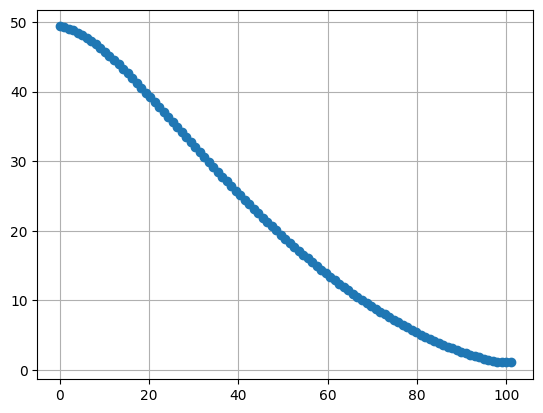

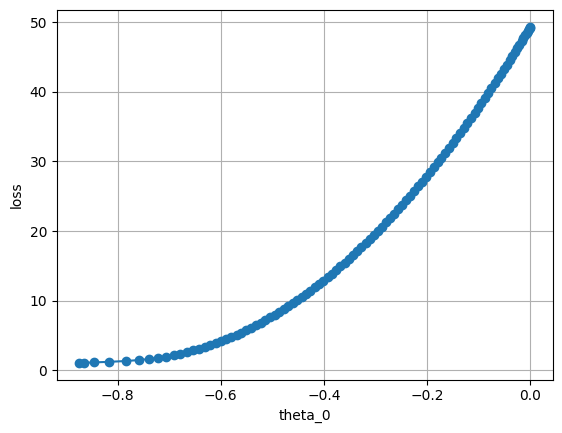

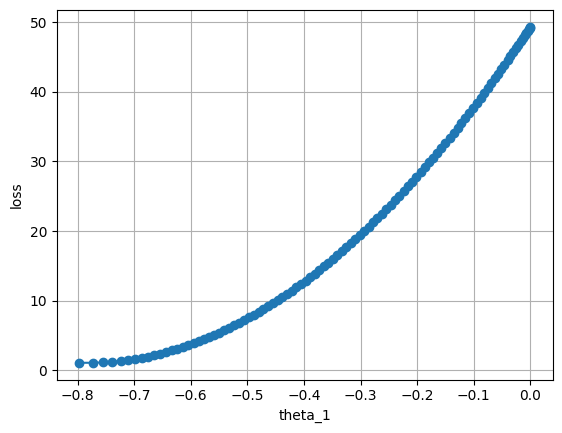

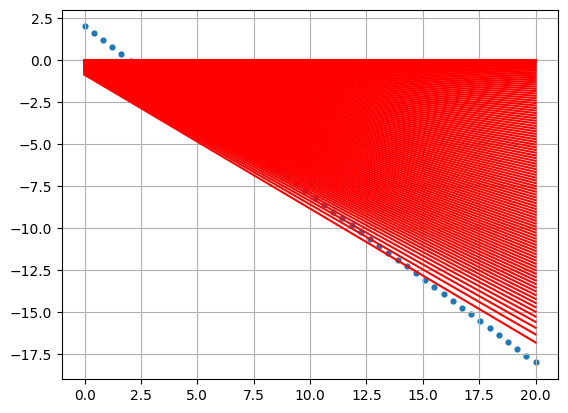

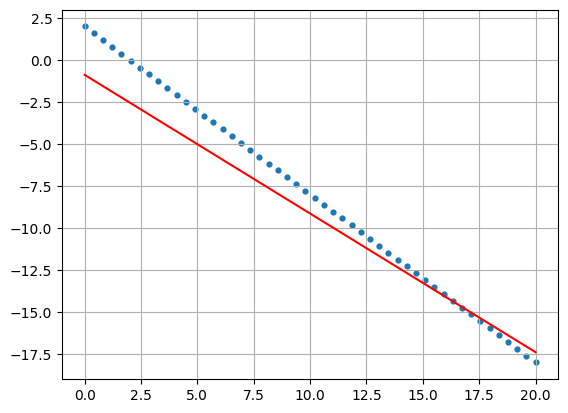

In [82]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.99, epsilon = 1e-08, and max. iterations = 5000.


In [83]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.001,1e-08,0.5,0.99,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.00099999999875
-0.0009999999999128113
Gradiant_vec_norm = 114.97254258164628
*****************

-0.6766338150712317
-0.7543011423301095
[ -0.67663382  -0.98451183  -1.29238985  -1.60026787  -1.90814588
  -2.2160239   -2.52390192  -2.83177994  -3.13965795  -3.44753597
  -3.75541399  -4.06329201  -4.37117002  -4.67904804  -4.98692606
  -5.29480407  -5.60268209  -5.91056011  -6.21843813  -6.52631614
  -6.83419416  -7.14207218  -7.4499502   -7.75782821  -8.06570623
  -8.37358425  -8.68146226  -8.98934028  -9.2972183   -9.60509632
  -9.91297433 -10.22085235 -10.52873037 -10.83660839 -11.1444864
 -11.45236442 -11.76024244 -12.06812045 -12.37599847 -12.68387649
 -12.99175451 -13.29963252 -13.60751054 -13.91538856 -14.22326658
 -14.53114459 -14.83902261 -15.14690063 -15.45477864 -15.76265666]
0.9382415081007449


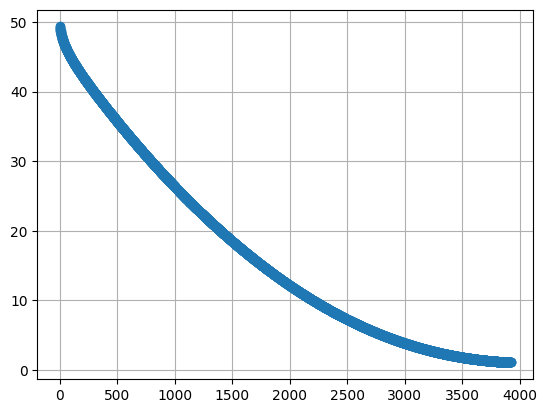

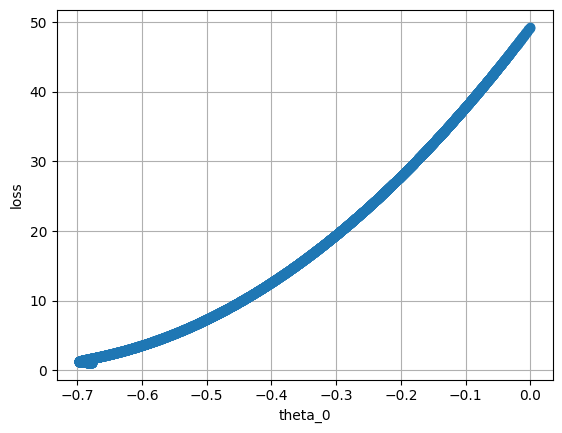

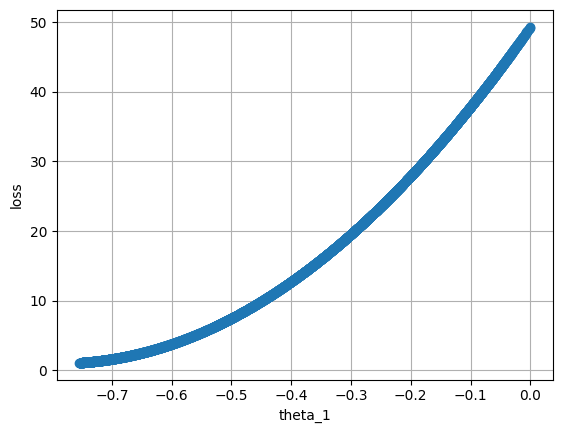

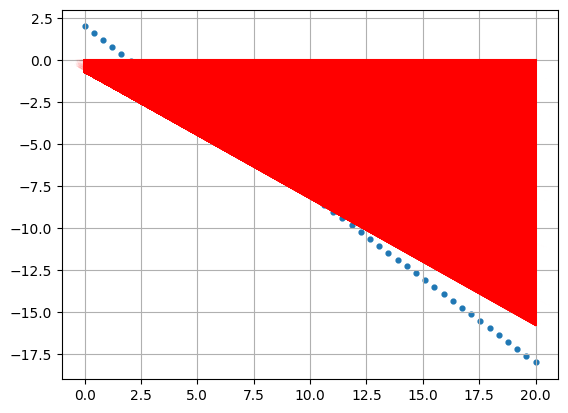

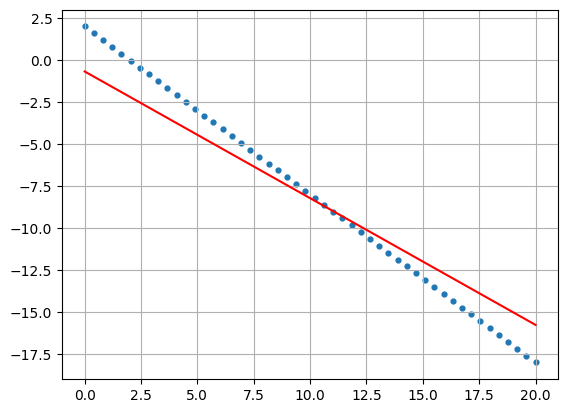

In [84]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.5, epsilon = 1e-08, and max. iterations = 5000.


In [85]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.001,1e-08,0.5,0.5,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.00099999999875
-0.0009999999999128113
Gradiant_vec_norm = 114.97254258164628
*****************

-0.6522405008528097
-0.803844350700603
[ -0.6522405   -0.98034024  -1.30843997  -1.63653971  -1.96463944
  -2.29273918  -2.62083891  -2.94893865  -3.27703838  -3.60513812
  -3.93323785  -4.26133759  -4.58943732  -4.91753706  -5.24563679
  -5.57373653  -5.90183626  -6.229936    -6.55803573  -6.88613547
  -7.2142352   -7.54233494  -7.87043467  -8.19853441  -8.52663414
  -8.85473388  -9.18283361  -9.51093335  -9.83903308 -10.16713282
 -10.49523255 -10.82333229 -11.15143202 -11.47953176 -11.80763149
 -12.13573123 -12.46383096 -12.7919307  -13.12003043 -13.44813017
 -13.7762299  -14.10432964 -14.43242937 -14.7605291  -15.08862884
 -15.41672857 -15.74482831 -16.07292804 -16.40102778 -16.72912751]
0.9477728579909405


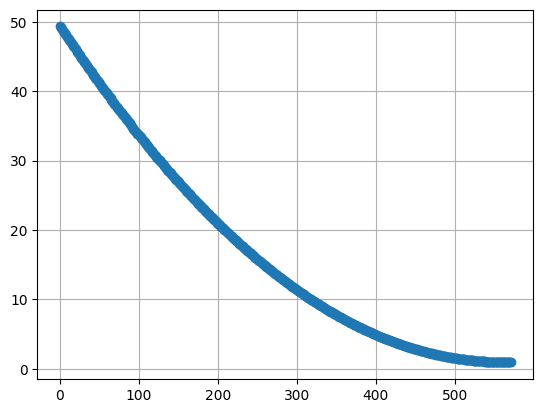

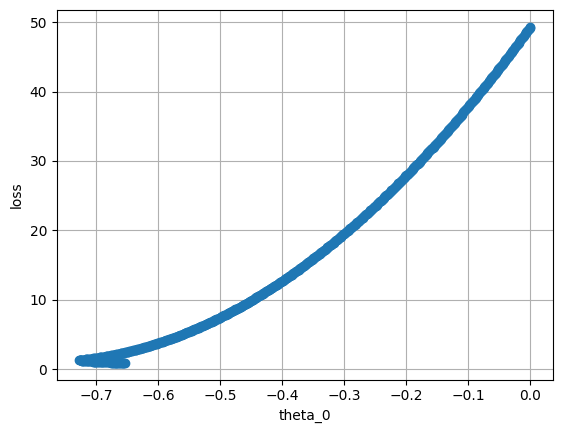

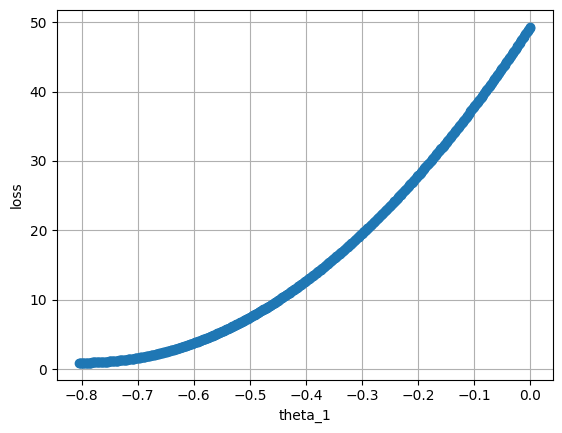

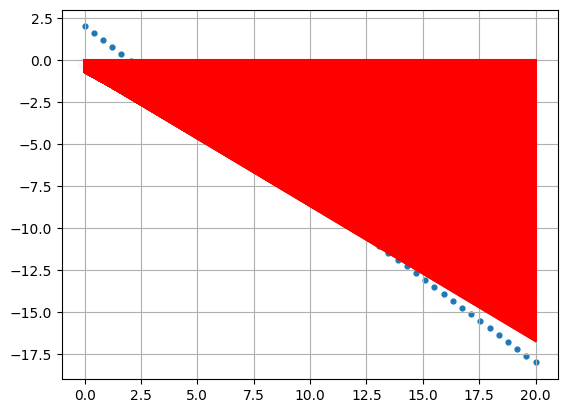

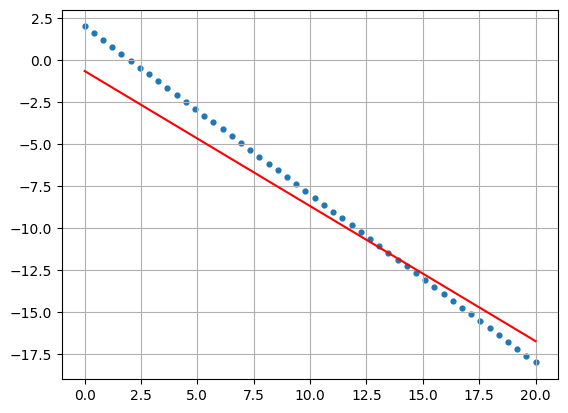

In [86]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

##### The following results uses alpha = 0.01, beta1 = 0.9, beta2 = 0.99, epsilon = 1e-08, and max. iterations = 5000.


In [87]:
theta_0_list,theta_1_list,loss_list,theta_0,theta_1 = GD(X,y,0.01,1e-08,0.9,0.99,5000)

************************* iter 0 *************************
y_predict
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
error vector
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]
j = 49.346938775510196
[[  8.        ]
 [114.69387755]]
-0.0099999999875
-0.009999999999128114
Gradiant_vec_norm = 114.97254258164628
*******************

1.2098639126097983
-0.9402836040862064
[  1.20986391   0.82607469   0.44228546   0.05849623  -0.32529299
  -0.70908222  -1.09287144  -1.47666067  -1.8604499   -2.24423912
  -2.62802835  -3.01181758  -3.3956068   -3.77939603  -4.16318525
  -4.54697448  -4.93076371  -5.31455293  -5.69834216  -6.08213138
  -6.46592061  -6.84970984  -7.23349906  -7.61728829  -8.00107752
  -8.38486674  -8.76865597  -9.15244519  -9.53623442  -9.92002365
 -10.30381287 -10.6876021  -11.07139132 -11.45518055 -11.83896978
 -12.222759   -12.60654823 -12.99033746 -13.37412668 -13.75791591
 -14.14170513 -14.52549436 -14.90928359 -15.29307281 -15.67686204
 -16.06065126 -16.44444049 -16.82822972 -17.21201894 -17.59580817]
0.9953606144874034


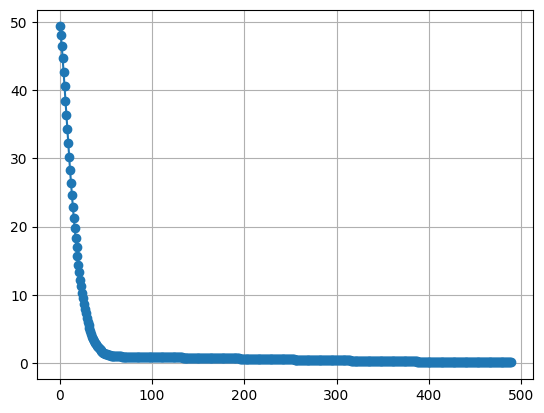

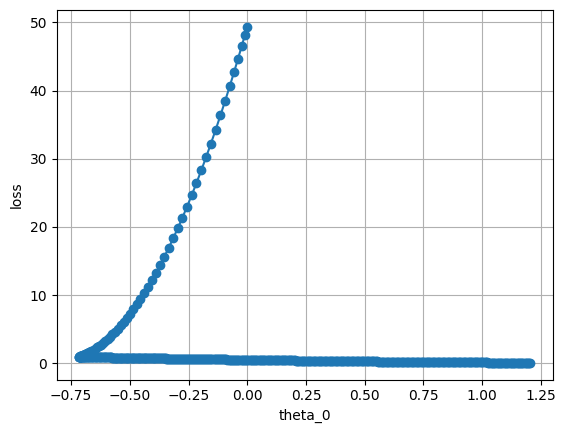

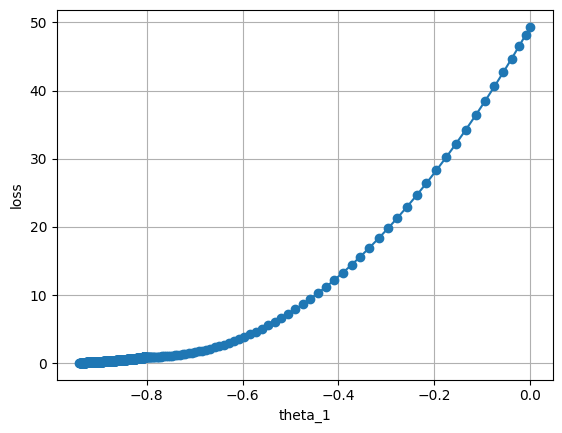

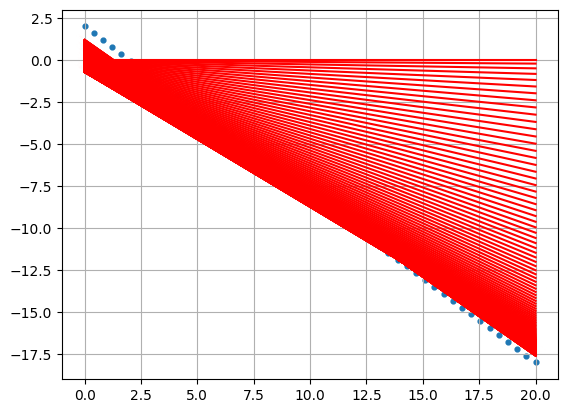

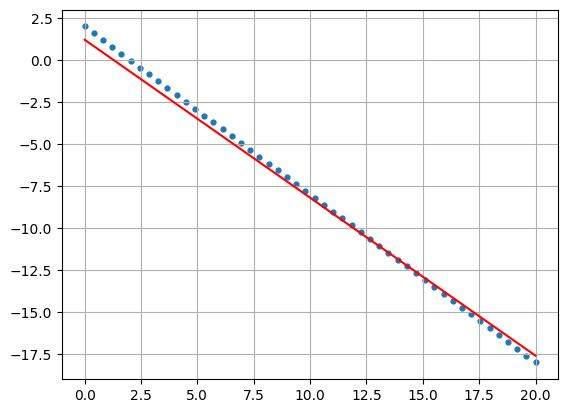

In [88]:
r2_s(theta_0,theta_1,X,y)
plot_loss_epocs(loss_list)
plot_theta_loss(loss_list,theta_0_list,theta_1_list)
plot_regression_lines(theta_0_list,theta_1_list,X,y)
plot_best_regression_line(theta_0,theta_1,X,y)

## Congratulations

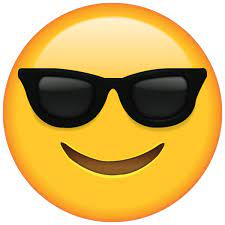
